In [205]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
import matplotlib.pyplot as plt
%matplotlib inline

In [193]:
df = pd.read_csv('ecommerce_data.csv')
df.head()

,is_mobile,n_products_viewed,visit_duration,is_returning_visitor,time_of_day,user_action
0,1,0,0.657510,0,3,0
1,1,1,0.568571,0,2,1
2,1,0,0.042246,1,1,0
3,1,1,1.659793,1,1,2
4,0,1,2.014745,1,1,2


In [194]:
scaler = StandardScaler()
df.n_products_viewed = scaler.fit_transform(df.n_products_viewed.reshape(-1,1))
df.visit_duration = scaler.fit_transform(df.visit_duration.reshape(-1,1))
temp = df.values

C:\Users\parmeets\AppData\Local\Continuum\Anaconda2\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  from ipykernel import kernelapp as app
C:\Users\parmeets\AppData\Local\Continuum\Anaconda2\lib\site-packages\ipykernel\__main__.py:3: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  app.launch_new_instance()


In [195]:
X = temp[:,:-1]
y = temp[:,-1]

In [196]:
enc = OneHotEncoder(sparse=False,categorical_features=[0,3,4])
encT = OneHotEncoder(sparse=False,categorical_features=[0])

In [197]:
X = enc.fit_transform(X)
y = y.reshape(-1,1)
y =  encT.fit_transform(y)

In [198]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [199]:
def sigmoid(X):
    return 1/(1+np.exp(-1*Z))
def softmax(X):
    expX = np.exp(X)
    return expX/np.sum(expX,axis=1,keepdims=True)
def forward(X,W1,W2,Z,b1,b2):
    Z = sigmoid(X.dot(W1) + b1)
    a2 = Z.dot(W2) + b2
    return softmax(a2)

Train Costs: -0.604127023947 Prediction rate 0.202985074627
Test Costs: -0.550401770055 Prediction rate 0.181818181818
Train Costs: -0.604071949869 Prediction rate 0.202985074627
Test Costs: -0.550352387867 Prediction rate 0.181818181818
Train Costs: -0.604016881396 Prediction rate 0.202985074627
Test Costs: -0.550303011235 Prediction rate 0.181818181818
Train Costs: -0.603961818528 Prediction rate 0.202985074627
Test Costs: -0.550253640159 Prediction rate 0.181818181818
Train Costs: -0.603906761265 Prediction rate 0.202985074627
Test Costs: -0.550204274639 Prediction rate 0.181818181818
Train Costs: -0.603851709606 Prediction rate 0.202985074627
Test Costs: -0.550154914675 Prediction rate 0.181818181818
Train Costs: -0.603796663551 Prediction rate 0.202985074627
Test Costs: -0.550105560266 Prediction rate 0.181818181818
Train Costs: -0.603741623099 Prediction rate 0.202985074627
Test Costs: -0.550056211412 Prediction rate 0.181818181818
Train Costs: -0.603686588252 Prediction rate 0.2

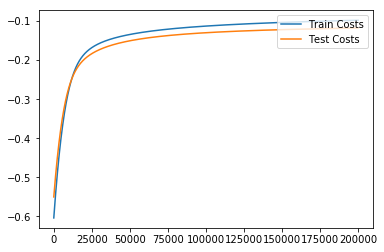

In [212]:
W = np.random.randn(X_train.shape[1],y_train.shape[1])
b = np.zeros(y_train.shape[1])

learning_rate = 10e-7
test_costs = []
train_costs = []
for x in xrange(200000):
    Z = softmax(X_train.dot(W) + b)
    Ztest = softmax(X_test.dot(W)+b)
    
    cost = np.mean(y_train*np.log(Z))
    testcost = np.mean(y_test*np.log(Ztest))
    
    train_costs.append(cost)
    test_costs.append(testcost)
    
    Ztesttrue = np.argmax(y_test,axis=1)
    Ztest = np.argmax(Ztest,axis=1)
    
    Ztraintrue = np.argmax(y_train,axis=1)
    Ztrain = np.argmax(Z,axis=1)
    
    classification_rate = np.mean(Ztesttrue==Ztest)
    classification_rate_train = np.mean(Ztraintrue==Ztrain)
    
    
    print "Train Costs:",cost,"Prediction rate",classification_rate_train
    print "Test Costs:",testcost,"Prediction rate",classification_rate
    
    W += learning_rate*X_train.T.dot(y_train-Z)
    
plt.plot(train_costs,label="Train Costs")
plt.plot(test_costs,label="Test Costs")
plt.legend(loc='upper right')
plt.show()